# GD_04

## 1.Semantic Segmentation

### 1.1 Module

In [ ]:
import os
import cv2
import math
import numpy as np
import tensorflow as tf
from tensorflow import keras
from PIL import Image
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.transform import resize
from glob import glob
from google.colab import drive
from google.colab.patches import cv2_imshow
from keras.models import Model
from keras import backend as K
from tensorflow.keras.utils import plot_model
from albumentations import  HorizontalFlip, RandomSizedCrop, Compose, OneOf, Resize

In [ ]:
def build_augmentation(is_train=True):
  if is_train:    # 훈련용 데이터일 경우
    return Compose([
                    HorizontalFlip(p=0.5),    # 50%의 확률로 좌우대칭
                    RandomSizedCrop(         # 50%의 확률로 RandomSizedCrop
                        min_max_height=(300, 370),
                        w2h_ratio=370/1242,
                        height=224,
                        width=224,
                        p=0.5
                        ),
                    Resize(              # 입력이미지를 224X224로 resize
                        width=224,
                        height=224
                        )
                    ])
  return Compose([      # 테스트용 데이터일 경우에는 224X224로 resize만 수행합니다. 
                Resize(
                    width=224,
                    height=224
                    )
                ])

In [ ]:
tf.__version__

'2.8.2'

In [ ]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

### 1.2 Data

In [ ]:
drive.mount('/gdrive')

Mounted at /gdrive


In [ ]:
dir_path = '/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train'

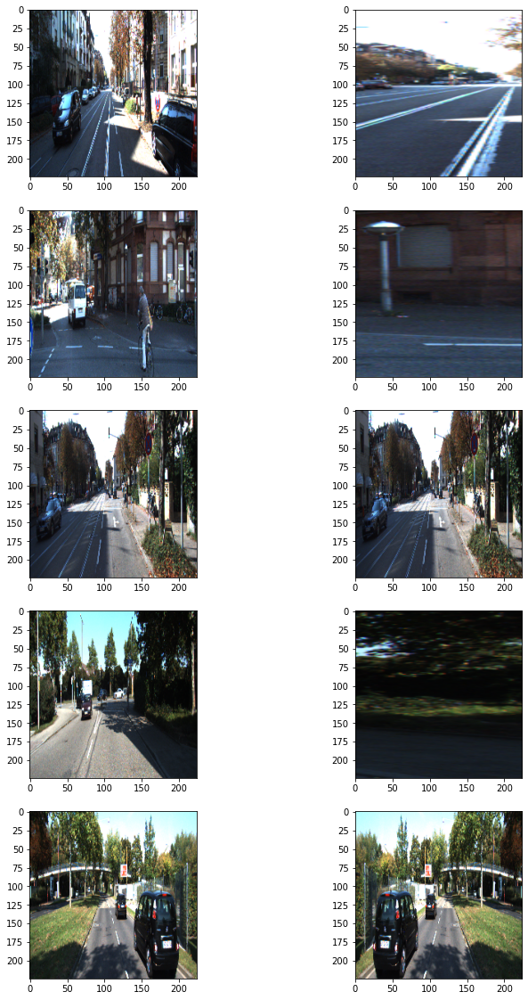

In [ ]:
augmentation_train = build_augmentation()
augmentation_test = build_augmentation(is_train=False)
input_images = glob(os.path.join(dir_path, "image_2", "*.png"))

# 훈련 데이터셋에서 5개만 가져와 augmentation을 적용해 봅시다.  
plt.figure(figsize=(12, 20))
for i in range(5):
    image = imread(input_images[i]) 
    image_data = {"image":image}
    resized = augmentation_test(**image_data)
    processed = augmentation_train(**image_data)
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(resized["image"])  # 왼쪽이 원본이미지
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(processed["image"])  # 오른쪽이 augment된 이미지
  
plt.show()

In [ ]:
class KittiGenerator(tf.keras.utils.Sequence):
  '''
  KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
  우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
  '''
  def __init__(self, 
               dir_path,
               batch_size=16,
               img_size=(224, 224, 3),
               output_size=(224, 224),
               is_train=True,
               augmentation=None):
    '''
    dir_path: dataset의 directory path입니다.
    batch_size: batch_size입니다.
    img_size: preprocess에 사용할 입력이미지의 크기입니다.
    output_size: ground_truth를 만들어주기 위한 크기입니다.
    is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
    augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
    '''
    self.dir_path = dir_path
    self.batch_size = batch_size
    self.is_train = is_train
    self.dir_path = dir_path
    self.augmentation = augmentation
    self.img_size = img_size
    self.output_size = output_size

    # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
    self.data = self.load_dataset()

  def load_dataset(self):
    # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
    # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
    input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
    label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
    input_images.sort()
    label_images.sort()
    assert len(input_images) == len(label_images)
    data = [ _ for _ in zip(input_images, label_images)]

    if self.is_train:
      return data[:-30]
    return data[-30:]
    
  def __len__(self):
    # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
    return math.ceil(len(self.data) / self.batch_size)

  def __getitem__(self, index):
    # 입력과 출력을 만듭니다.
    # 입력은 resize및 augmentation이 적용된 input image이고 
    # 출력은 semantic label입니다.
    batch_data = self.data[
                           index*self.batch_size:
                           (index + 1)*self.batch_size
                           ]
    inputs = np.zeros([self.batch_size, *self.img_size])
    outputs = np.zeros([self.batch_size, *self.output_size])
        
    for i, data in enumerate(batch_data):
      input_img_path, output_path = data
      _input = imread(input_img_path)
      _output = imread(output_path)
      _output = (_output==7).astype(np.uint8)*1
      data = {
          "image": _input,
          "mask": _output,
          }
      augmented = self.augmentation(**data)
      inputs[i] = augmented["image"]/255
      outputs[i] = augmented["mask"]
      return inputs, outputs

  def on_epoch_end(self):
    # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
    self.indexes = np.arange(len(self.data))
    if self.is_train == True :
      np.random.shuffle(self.indexes)
      return self.indexes

In [ ]:
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)
        
train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_train=False
)

### 1.3 Unet

#### 1.3.1 Model

In [ ]:
def unet_model(input_shape=(224, 224, 3)):
  inputs = keras.layers.Input(input_shape)
    
  #Contracting Path
  conv1 = keras.layers.Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(inputs)
  conv1 = keras.layers.Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv1)
  pool1 = keras.layers.MaxPooling2D(pool_size=(2, 2))(conv1)
  conv2 = keras.layers.Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool1)
  conv2 = keras.layers.Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv2)
  pool2 = keras.layers.MaxPooling2D(pool_size=(2, 2))(conv2)
  conv3 = keras.layers.Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool2)
  conv3 = keras.layers.Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv3)
  pool3 = keras.layers.MaxPooling2D(pool_size=(2, 2))(conv3)
  conv4 = keras.layers.Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool3)
  conv4 = keras.layers.Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv4)
  drop4 = keras.layers.Dropout(0.5)(conv4)
  pool4 = keras.layers.MaxPooling2D(pool_size=(2, 2))(drop4)
  
  conv5 = keras.layers.Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool4)  
  conv5 = keras.layers.Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv5)
  
  #Expanding Path
  drop5 = keras.layers.Dropout(0.5)(conv5)
  up6 = keras.layers.Conv2DTranspose(512, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(drop5)
  merge6 = keras.layers.concatenate([drop4,up6], axis = 3)
  conv6 = keras.layers.Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge6)
  conv6 = keras.layers.Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv6)
  up7 = keras.layers.Conv2DTranspose(256, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(conv6)
  merge7 = keras.layers.concatenate([conv3,up7], axis = 3)
  conv7 = keras.layers.Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge7)
  conv7 = keras.layers.Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv7)
  up8 = keras.layers.Conv2DTranspose(128, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(conv7)
  merge8 = keras.layers.concatenate([conv2,up8], axis = 3)
  conv8 = keras.layers.Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge8)
  conv8 = keras.layers.Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv8)
  up9 = keras.layers.Conv2DTranspose(64, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(conv8)
  merge9 = keras.layers.concatenate([conv1,up9], axis = 3)
  conv9 = keras.layers.Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge9)
  conv9 = keras.layers.Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)  
  conv9 = keras.layers.Conv2D(2, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)     
  conv10 = keras.layers.Conv2D(1, 1, activation='sigmoid')(conv9)

  model = Model(inputs = inputs, outputs = conv10)
  return model

In [ ]:
unet_0 = unet_model((224, 224, 3))

#### 1.3.2 Summary

In [ ]:
unet_0.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 224, 224, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 224, 224, 64  36928       ['conv2d[0][0]']                 
                                )                                                             

#### 1.3.3 Architecture

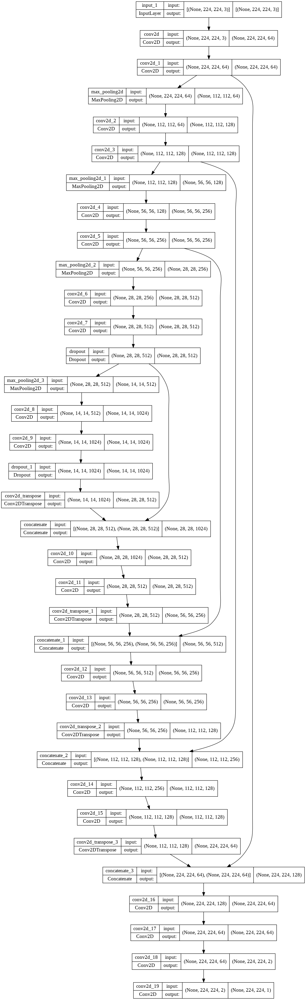

In [ ]:
plot_model(unet_0, to_file='unet_shapes.png', show_shapes=True)

#### 1.3.4 Train

##### 1) Setting

In [ ]:
model_path = '/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/model'
unet_0.compile(optimizer = tf.keras.optimizers.Adam(1e-4), loss="binary_crossentropy")

##### 2) Training

In [ ]:
unet_0.fit(
     train_generator,
     validation_data=test_generator,
     steps_per_epoch=len(train_generator),
     epochs=100,
 )

unet_0.save(model_path + '/unet_0.h5')  #학습한 모델 저장

Epoch 1/100
11/11 [==============================] - 9s 660ms/step - loss: 0.6870 - val_loss: 0.6753
Epoch 2/100
11/11 [==============================] - 7s 637ms/step - loss: 0.6180 - val_loss: 0.3809
Epoch 3/100
11/11 [==============================] - 7s 630ms/step - loss: 0.0712 - val_loss: 0.0339
Epoch 4/100
11/11 [==============================] - 7s 629ms/step - loss: 0.0273 - val_loss: 0.0315
Epoch 5/100
11/11 [==============================] - 7s 628ms/step - loss: 0.0291 - val_loss: 0.0315
Epoch 6/100
11/11 [==============================] - 7s 625ms/step - loss: 0.0292 - val_loss: 0.0318
Epoch 7/100
11/11 [==============================] - 7s 622ms/step - loss: 0.0275 - val_loss: 0.0268
Epoch 8/100
11/11 [==============================] - 7s 619ms/step - loss: 0.0281 - val_loss: 0.0339
Epoch 9/100
11/11 [==============================] - 7s 617ms/step - loss: 0.0279 - val_loss: 0.0229
Epoch 10/100
11/11 [==============================] - 7s 613ms/step - loss: 0.0202 - val_lo

##### 3) Prediction

In [ ]:
# model load
# model = tf.keras.models.load_model(model_path)

In [ ]:
def get_output(model, preproc, threshold, image_path, output_path):
     origin_img = imread(image_path)
     data = {"image":origin_img}
     processed = preproc(**data)
     output = model(np.expand_dims(processed["image"]/255,axis=0))
     output = (output[0].numpy()>threshold).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
     output = Image.fromarray(output)
     background = Image.fromarray(origin_img).convert('RGBA')
     output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
     output = Image.blend(background, output, alpha=0.5)
     output.show()
     return output

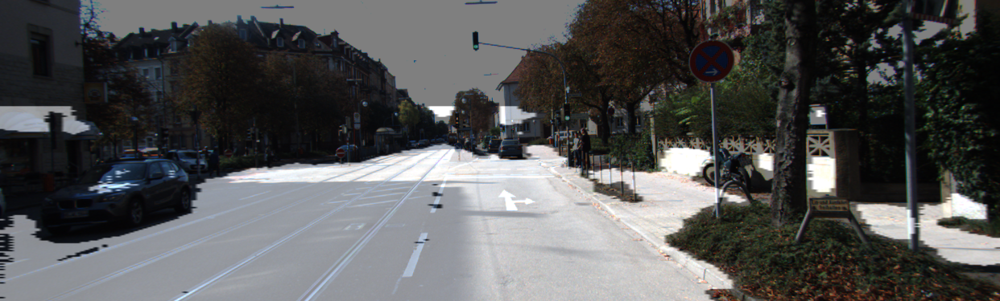

In [ ]:
# 완성한 뒤에는 시각화한 결과를 눈으로 확인해봅시다!
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
get_output(unet_0, 
           test_preproc,
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
def calculate_iou_score(target, prediction):
    intersection = np.logical_and(target, prediction)
    union = np.logical_or(target, prediction)
    iou_score = float(np.sum(intersection)) / float(np.sum(union))
    print('IoU : %f' % iou_score )
    return iou_score

In [ ]:
def get_output_2(model, preproc, threshold, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    output = (output[0].numpy()>=threshold).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
    output.show()   # 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역
        

        return output, prediction, target
    else:
        return output, prediction, _

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
output, prediction, target = get_output_2(unet_0, 
                                          test_preproc,
                                          0.5,
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

# output.show()   # 도로로 판단한 영역을 시각화!
calculate_iou_score(target, prediction)

IoU : 0.768853


0.768853387005472

### 1.4 Unet++

#### 1.4.1 Model

In [ ]:
def down_conv_block(m, filter_mult, filters, kernel_size, name=None):
   # step 1
    m = keras.layers.Conv2D(filter_mult * filters, kernel_size, padding='same', activation='relu')(m)
    m = keras.layers.BatchNormalization()(m)
   # step 2
    m = keras.layers.Conv2D(filter_mult * filters, kernel_size, padding='same', activation='relu')(m)
    m = keras.layers.BatchNormalization(name=name)(m)
    return m

In [ ]:
def up_conv_block(m, prev, filter_mult, filters, kernel_size, prev_2=None, prev_3=None, prev_4=None, name=None):
    m = keras.layers.Conv2DTranspose(filter_mult * filters, kernel_size, strides=(2, 2), padding='same', activation='relu')(m)
    m = keras.layers.BatchNormalization()(m)

    # Concatenate layers; varies between UNet and UNet++
    if prev_4 is not None:
        m = keras.layers.Concatenate()([m, prev, prev_2, prev_3, prev_4])
    elif prev_3 is not None:
        m = keras.layers.Concatenate()([m, prev, prev_2, prev_3])
    elif prev_2 is not None:
        m = keras.layers.Concatenate()([m, prev, prev_2])
    else:
        m = keras.layers.Concatenate()([m, prev])

    m = keras.layers.Conv2D(filter_mult * filters, kernel_size, padding='same', activation='relu')(m)
    m = keras.layers.BatchNormalization(name=name)(m)

    return m

In [ ]:
def build_model(input_shape, filters, kernel_size):
  inputs = keras.layers.Input(input_shape)
    
  # First downsampling stage
  conv0_0 = down_conv_block(inputs, 1, filters, kernel_size, name='conv0_0')
  pool0_0 = keras.layers.MaxPooling2D((2, 2))(conv0_0)
  conv1_0 = down_conv_block(pool0_0, 2, filters, kernel_size, name='conv1_0')

  # Second downsampling stage
  pool1_0 = keras.layers.MaxPooling2D((2, 2))(conv1_0)
  conv2_0 = down_conv_block(pool1_0, 4, filters, kernel_size, name='conv2_0')

  # Third downsampling stage
  pool2_0 = keras.layers.MaxPooling2D((2, 2))(conv2_0)
  conv3_0 = down_conv_block(pool2_0, 8, filters, kernel_size, name='conv3_0')

  # Fourth downsampling stage
  pool3_0 = keras.layers.MaxPooling2D((2, 2))(conv3_0)
  conv4_0 = down_conv_block(pool3_0, 16, filters, kernel_size, name='conv4_0')

  # First upsampling stage
  conv0_1 = up_conv_block(conv1_0, conv0_0, 1, filters, kernel_size, name='conv0_1')
  out = conv0_1

  # Second upsampling stage
  conv1_1 = up_conv_block(conv2_0, conv1_0, 2, filters, kernel_size, name='conv1_1')
  conv0_2 = up_conv_block(conv1_1, conv0_1, 1, filters, kernel_size, prev_2=conv0_0, name='conv0_2')
  out = conv0_2

  # Third upsampling stage
  conv2_1 = up_conv_block(conv3_0, conv2_0, 4, filters, kernel_size, name='conv2_1')
  conv1_2 = up_conv_block(conv2_1, conv1_1, 2, filters, kernel_size, prev_2=conv1_0, name='conv1_2')
  conv0_3 = up_conv_block(conv1_2, conv0_2, 1, filters, kernel_size, prev_2=conv0_1, prev_3=conv0_0, name='conv0_3')
  out = conv0_3

  # Fourth upsampling stage
  conv3_1 = up_conv_block(conv4_0, conv3_0, 8, filters, kernel_size, name='conv3_1')
  conv2_2 = up_conv_block(conv3_1, conv2_1, 4, filters, kernel_size, prev_2=conv2_0, name='conv2_2')
  conv1_3 = up_conv_block(conv2_2, conv1_2, 2, filters, kernel_size, prev_2=conv1_1, prev_3=conv1_0, name='conv1_3')
  conv0_4 = up_conv_block(conv1_3, conv0_3, 1, filters, kernel_size, prev_2=conv0_2, prev_3=conv0_1, prev_4=conv0_0, name='conv0_4')
  out = conv0_4

  conv_L_0 = keras.layers.Conv2D(2, 3, padding='same', activation='relu')(out)
  conv_L_1 = keras.layers.Conv2D(1, 1, padding='same', activation='sigmoid')(conv_L_0)

  model = Model(inputs = inputs, outputs = conv_L_1)
  return model

In [ ]:
unet_pp_0 = build_model((224, 224, 3), 64, 3)

#### 1.4.2 Summary

In [ ]:
unet_pp_0.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 224, 224, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 224, 224, 64  256        ['conv2d[0][0]']                 
 alization)                     )                                                             

#### 1.4.3 Architecture

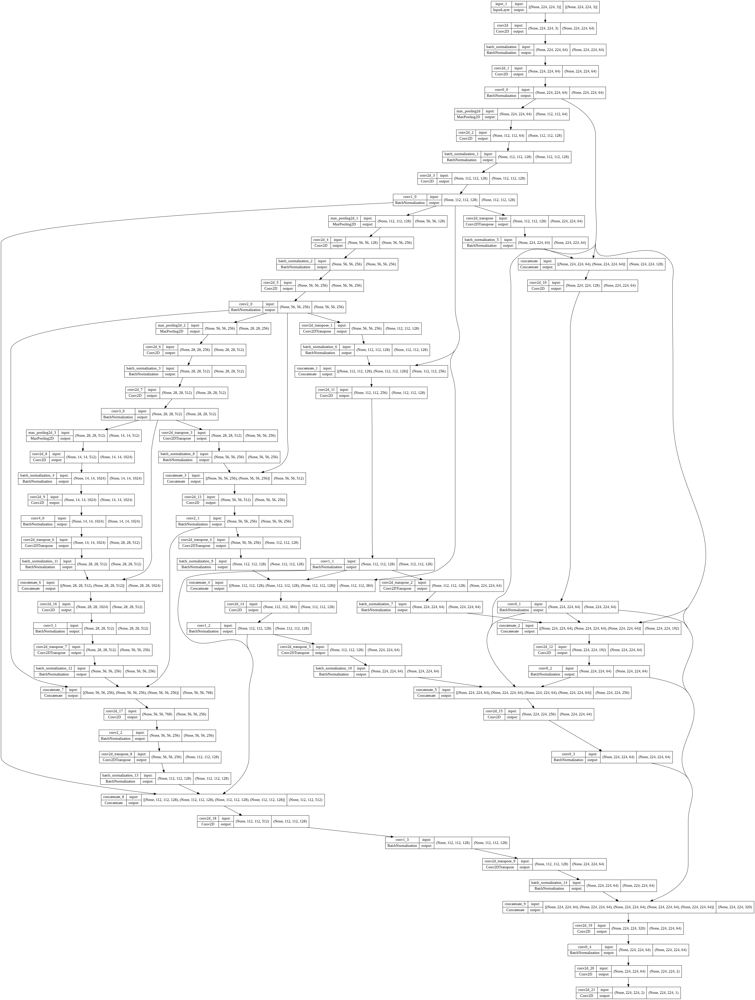

In [ ]:
plot_model(unet_pp_0, to_file='unet_pp_shapes.png', show_shapes=True)

#### 1.4.4 Train

##### 1) Setting

In [ ]:
model_path = '/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/model'
unet_pp_0.compile(optimizer = tf.keras.optimizers.Adam(1e-4), loss="binary_crossentropy")

##### 2) Traning

In [ ]:
unet_pp_0.fit(
     train_generator,
     validation_data=test_generator,
     steps_per_epoch=len(train_generator),
     epochs=100,
 )

unet_pp_0.save(model_path + '/unet_pp_0.h5')  #학습한 모델 저장

Epoch 1/100
11/11 [==============================] - 71s 3s/step - loss: 0.8559 - val_loss: 0.6929
Epoch 2/100
11/11 [==============================] - 19s 2s/step - loss: 0.7500 - val_loss: 0.6926
Epoch 3/100
11/11 [==============================] - 20s 2s/step - loss: 0.7219 - val_loss: 0.6922
Epoch 4/100
11/11 [==============================] - 21s 2s/step - loss: 0.7118 - val_loss: 0.6917
Epoch 5/100
11/11 [==============================] - 20s 2s/step - loss: 0.6976 - val_loss: 0.6915
Epoch 6/100
11/11 [==============================] - 20s 2s/step - loss: 0.6998 - val_loss: 0.6909
Epoch 7/100
11/11 [==============================] - 20s 2s/step - loss: 0.6949 - val_loss: 0.6904
Epoch 8/100
11/11 [==============================] - 20s 2s/step - loss: 0.6893 - val_loss: 0.6900
Epoch 9/100
11/11 [==============================] - 20s 2s/step - loss: 0.6873 - val_loss: 0.6895
Epoch 10/100
11/11 [==============================] - 20s 2s/step - loss: 0.6936 - val_loss: 0.6888
Epoch 11/

##### 3) Prediction

In [ ]:
# model load
# model = tf.keras.models.load_model(model_path)

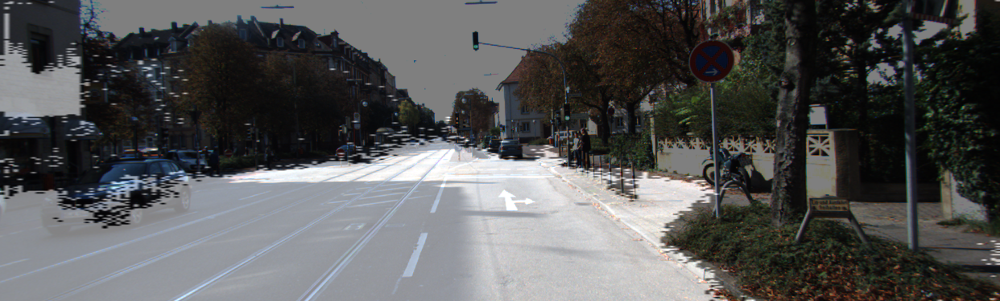

In [ ]:
# 완성한 뒤에는 시각화한 결과를 눈으로 확인해봅시다!
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
get_output(
           unet_pp_0, 
           test_preproc, 
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
output, prediction, target = get_output_2(
                                          unet_pp_0, 
                                          test_preproc,
                                          0.5,
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

# output.show()   # 도로로 판단한 영역을 시각화!
calculate_iou_score(target, prediction)

IoU : 0.796547


0.7965471614895092

## 2. Improve

### 2.1 Optimizer

#### 2.1.1 Adam

##### 1) Adam(5e-3)

In [ ]:
unet_pp_1_1 = build_model((224, 224, 3), 64, 3)
unet_pp_1_1.compile(optimizer = tf.keras.optimizers.Adam(5e-3), loss="binary_crossentropy")

In [ ]:
unet_pp_1_1.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=100
                )

unet_pp_1_1.save(model_path + '/unet_pp_1_1.h5')

Epoch 1/100
11/11 [==============================] - 28s 2s/step - loss: 0.8671 - val_loss: 14.6950
Epoch 2/100
11/11 [==============================] - 9s 836ms/step - loss: 0.6598 - val_loss: 3.8718
Epoch 3/100
11/11 [==============================] - 9s 837ms/step - loss: 0.6316 - val_loss: 0.6190
Epoch 4/100
11/11 [==============================] - 9s 835ms/step - loss: 0.6075 - val_loss: 0.5962
Epoch 5/100
11/11 [==============================] - 9s 835ms/step - loss: 0.5847 - val_loss: 0.5744
Epoch 6/100
11/11 [==============================] - 9s 836ms/step - loss: 0.5635 - val_loss: 0.5535
Epoch 7/100
11/11 [==============================] - 9s 839ms/step - loss: 0.5438 - val_loss: 0.5335
Epoch 8/100
11/11 [==============================] - 9s 835ms/step - loss: 0.5244 - val_loss: 0.5145
Epoch 9/100
11/11 [==============================] - 9s 837ms/step - loss: 0.5050 - val_loss: 0.4964
Epoch 10/100
11/11 [==============================] - 9s 837ms/step - loss: 0.4854 - val_los

In [ ]:
# model load
# unet_pp_1_1 = tf.keras.models.load_model(model_path + '/unet_pp_1_1.h5')

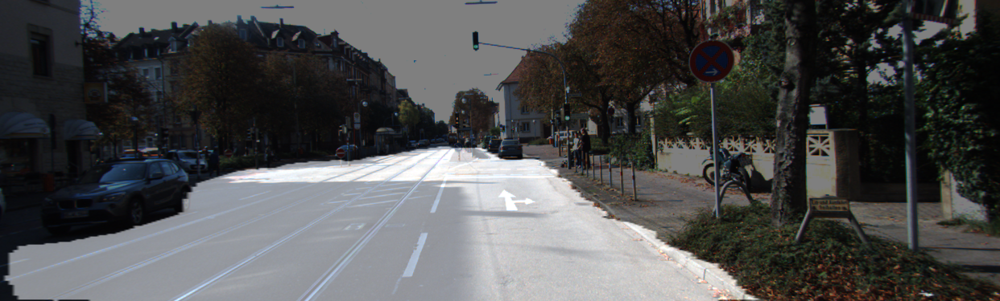

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_1_1, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_1_1, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.911255


0.9112545986935956

##### 2) Adam(1e-3)

In [ ]:
unet_pp_1_2 = build_model((224, 224, 3), 64, 3)
unet_pp_1_2.compile(optimizer = tf.keras.optimizers.Adam(1e-3), loss="binary_crossentropy")

In [ ]:
unet_pp_1_2.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=100
                )

unet_pp_1_2.save(model_path + '/unet_pp_1_2.h5')

Epoch 1/100
11/11 [==============================] - 39s 2s/step - loss: 0.1974 - val_loss: 0.5245
Epoch 2/100
11/11 [==============================] - 9s 837ms/step - loss: 0.0692 - val_loss: 0.2746
Epoch 3/100
11/11 [==============================] - 9s 837ms/step - loss: 0.0523 - val_loss: 0.1707
Epoch 4/100
11/11 [==============================] - 9s 835ms/step - loss: 0.0473 - val_loss: 0.1197
Epoch 5/100
11/11 [==============================] - 9s 836ms/step - loss: 0.0455 - val_loss: 0.0998
Epoch 6/100
11/11 [==============================] - 9s 836ms/step - loss: 0.0447 - val_loss: 0.0925
Epoch 7/100
11/11 [==============================] - 9s 836ms/step - loss: 0.0441 - val_loss: 0.0892
Epoch 8/100
11/11 [==============================] - 9s 838ms/step - loss: 0.0438 - val_loss: 0.0881
Epoch 9/100
11/11 [==============================] - 9s 837ms/step - loss: 0.0436 - val_loss: 0.0885
Epoch 10/100
11/11 [==============================] - 9s 835ms/step - loss: 0.0436 - val_loss

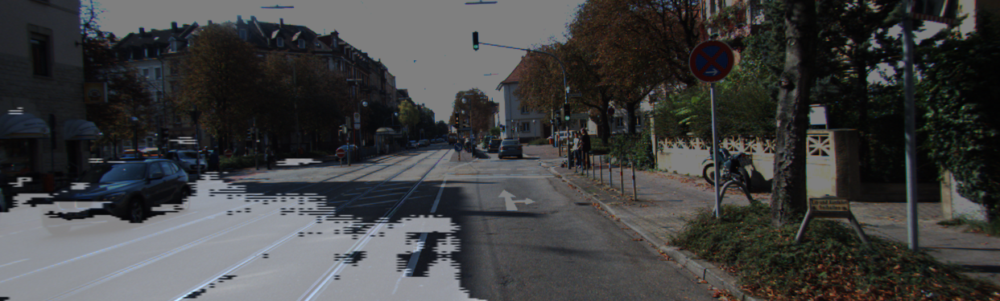

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_1_2, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_1_2, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.483386


0.4833861954387555

##### 3) Adam(5e-4)

In [ ]:
unet_pp_1_3 = build_model((224, 224, 3), 64, 3)
unet_pp_1_3.compile(optimizer = tf.keras.optimizers.Adam(5e-4), loss="binary_crossentropy", metrics=['accuracy'])

In [ ]:
unet_pp_1_3.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=100
                )

unet_pp_1_3.save(model_path + '/unet_pp_1_3.h5')

Epoch 1/100
11/11 [==============================] - 15s 987ms/step - loss: 0.9172 - accuracy: 0.2981 - val_loss: 0.6907 - val_accuracy: 0.9686
Epoch 2/100
11/11 [==============================] - 10s 902ms/step - loss: 0.7072 - accuracy: 0.5836 - val_loss: 0.6881 - val_accuracy: 0.9752
Epoch 3/100
11/11 [==============================] - 10s 903ms/step - loss: 0.6904 - accuracy: 0.8921 - val_loss: 0.6862 - val_accuracy: 0.9725
Epoch 4/100
11/11 [==============================] - 10s 903ms/step - loss: 0.6845 - accuracy: 0.9782 - val_loss: 0.6845 - val_accuracy: 0.9693
Epoch 5/100
11/11 [==============================] - 10s 905ms/step - loss: 0.6817 - accuracy: 0.9875 - val_loss: 0.6854 - val_accuracy: 0.8618
Epoch 6/100
11/11 [==============================] - 10s 903ms/step - loss: 0.6787 - accuracy: 0.9883 - val_loss: 0.6842 - val_accuracy: 0.8947
Epoch 7/100
11/11 [==============================] - 10s 903ms/step - loss: 0.6757 - accuracy: 0.9868 - val_loss: 0.6833 - val_accuracy:

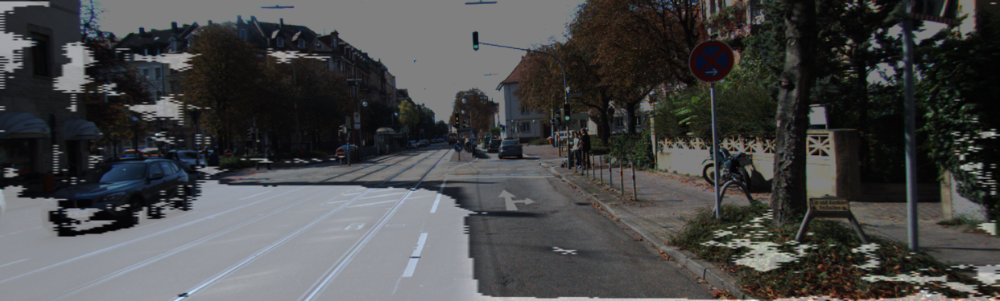

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_1_3, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_1_3, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.534625


0.5346245327896704

##### 4) Adam(1e-4)

In [ ]:
unet_pp_1_4 = build_model((224, 224, 3), 64, 3)
unet_pp_1_4.compile(optimizer = tf.keras.optimizers.Adam(1e-4), loss="binary_crossentropy")

In [ ]:
unet_pp_1_4.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=100
                )

unet_pp_1_4.save(model_path + '/unet_pp_1_4.h5')

Epoch 1/100
11/11 [==============================] - 15s 986ms/step - loss: 0.5842 - val_loss: 0.6920
Epoch 2/100
11/11 [==============================] - 10s 901ms/step - loss: 0.3990 - val_loss: 0.6857
Epoch 3/100
11/11 [==============================] - 10s 888ms/step - loss: 0.3476 - val_loss: 0.6830
Epoch 4/100
11/11 [==============================] - 10s 894ms/step - loss: 0.3278 - val_loss: 0.6814
Epoch 5/100
11/11 [==============================] - 10s 903ms/step - loss: 0.3135 - val_loss: 0.6677
Epoch 6/100
11/11 [==============================] - 10s 903ms/step - loss: 0.3040 - val_loss: 0.6602
Epoch 7/100
11/11 [==============================] - 10s 901ms/step - loss: 0.2985 - val_loss: 0.6558
Epoch 8/100
11/11 [==============================] - 10s 902ms/step - loss: 0.2947 - val_loss: 0.6458
Epoch 9/100
11/11 [==============================] - 10s 895ms/step - loss: 0.2906 - val_loss: 0.6444
Epoch 10/100
11/11 [==============================] - 10s 903ms/step - loss: 0.286

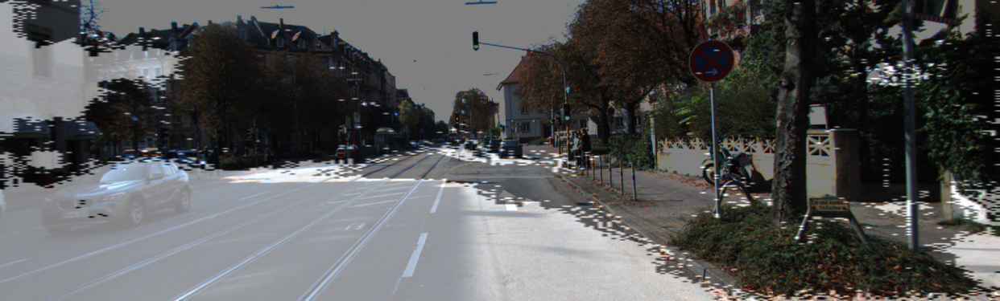

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_1_4, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_1_4, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.639283


0.6392832995267073

##### 5) Adam(5e-5)

In [ ]:
unet_pp_1_5 = build_model((224, 224, 3), 64, 3)
unet_pp_1_5.compile(optimizer = tf.keras.optimizers.Adam(5e-5), loss="binary_crossentropy")

In [ ]:
unet_pp_1_5.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=100
                )

unet_pp_1_5.save(model_path + '/unet_pp_1_5.h5')

Epoch 1/100
11/11 [==============================] - 15s 983ms/step - loss: 0.9009 - val_loss: 0.7047
Epoch 2/100
11/11 [==============================] - 10s 903ms/step - loss: 0.8005 - val_loss: 0.7128
Epoch 3/100
11/11 [==============================] - 10s 902ms/step - loss: 0.7626 - val_loss: 0.7163
Epoch 4/100
11/11 [==============================] - 10s 902ms/step - loss: 0.7452 - val_loss: 0.7218
Epoch 5/100
11/11 [==============================] - 10s 902ms/step - loss: 0.7284 - val_loss: 0.7267
Epoch 6/100
11/11 [==============================] - 10s 902ms/step - loss: 0.7250 - val_loss: 0.7266
Epoch 7/100
11/11 [==============================] - 10s 902ms/step - loss: 0.7208 - val_loss: 0.7292
Epoch 8/100
11/11 [==============================] - 10s 903ms/step - loss: 0.7070 - val_loss: 0.7299
Epoch 9/100
11/11 [==============================] - 10s 901ms/step - loss: 0.7077 - val_loss: 0.7318
Epoch 10/100
11/11 [==============================] - 10s 901ms/step - loss: 0.708

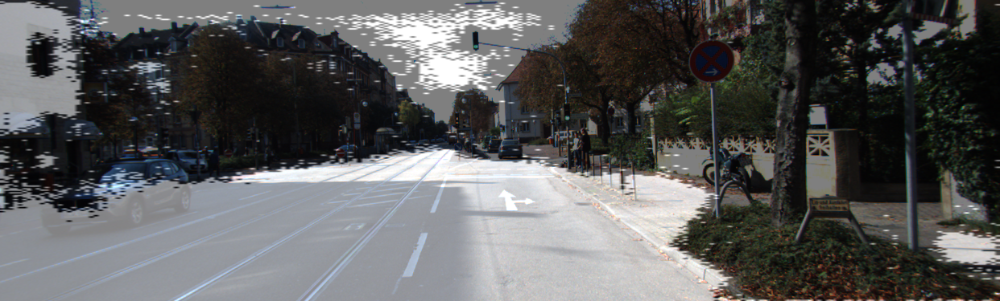

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_1_5, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_1_5, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.706189


0.7061893271982492

#### 2.1.2 Nadam

##### 1) Nadam(5e-3)

In [ ]:
unet_pp_2_1 = build_model((224, 224, 3), 64, 3)
unet_pp_2_1.compile(optimizer = tf.keras.optimizers.Nadam(5e-3), loss="binary_crossentropy")

In [ ]:
unet_pp_2_1.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=100
                )

unet_pp_2_1.save(model_path + '/unet_pp_2_1.h5')

Epoch 1/100
11/11 [==============================] - 23s 1s/step - loss: 0.4447 - val_loss: 0.6888
Epoch 2/100
11/11 [==============================] - 10s 917ms/step - loss: 0.3347 - val_loss: 0.6898
Epoch 3/100
11/11 [==============================] - 10s 925ms/step - loss: 0.2404 - val_loss: 0.6608
Epoch 4/100
11/11 [==============================] - 10s 924ms/step - loss: 0.1386 - val_loss: 0.6311
Epoch 5/100
11/11 [==============================] - 10s 918ms/step - loss: 0.0916 - val_loss: 0.6050
Epoch 6/100
11/11 [==============================] - 10s 917ms/step - loss: 0.0452 - val_loss: 0.6027
Epoch 7/100
11/11 [==============================] - 10s 918ms/step - loss: 0.0405 - val_loss: 0.5832
Epoch 8/100
11/11 [==============================] - 10s 916ms/step - loss: 0.0406 - val_loss: 0.5710
Epoch 9/100
11/11 [==============================] - 10s 920ms/step - loss: 0.0411 - val_loss: 0.5669
Epoch 10/100
11/11 [==============================] - 10s 918ms/step - loss: 0.0408 -

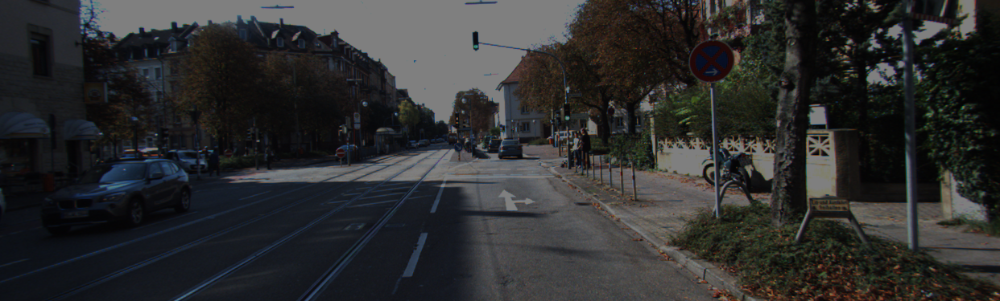

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_2_1, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_2_1, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.000000


0.0

##### 2) Nadam(1e-3)

In [ ]:
unet_pp_2_2 = build_model((224, 224, 3), 64, 3)
unet_pp_2_2.compile(optimizer = tf.keras.optimizers.Nadam(1e-3), loss="binary_crossentropy")

In [ ]:
unet_pp_2_2.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=100
                )

unet_pp_2_2.save(model_path + '/unet_pp_2_2.h5')

Epoch 1/100
11/11 [==============================] - 33s 2s/step - loss: 0.3934 - val_loss: 0.4663
Epoch 2/100
11/11 [==============================] - 10s 911ms/step - loss: 0.2172 - val_loss: 0.3402
Epoch 3/100
11/11 [==============================] - 10s 919ms/step - loss: 0.2011 - val_loss: 0.2943
Epoch 4/100
11/11 [==============================] - 10s 918ms/step - loss: 0.1987 - val_loss: 0.2609
Epoch 5/100
11/11 [==============================] - 10s 917ms/step - loss: 0.1986 - val_loss: 0.2469
Epoch 6/100
11/11 [==============================] - 10s 917ms/step - loss: 0.1966 - val_loss: 0.2342
Epoch 7/100
11/11 [==============================] - 10s 915ms/step - loss: 0.1948 - val_loss: 0.2274
Epoch 8/100
11/11 [==============================] - 10s 916ms/step - loss: 0.1898 - val_loss: 0.1433
Epoch 9/100
11/11 [==============================] - 10s 917ms/step - loss: 0.1795 - val_loss: 0.0863
Epoch 10/100
11/11 [==============================] - 10s 916ms/step - loss: 0.1532 -

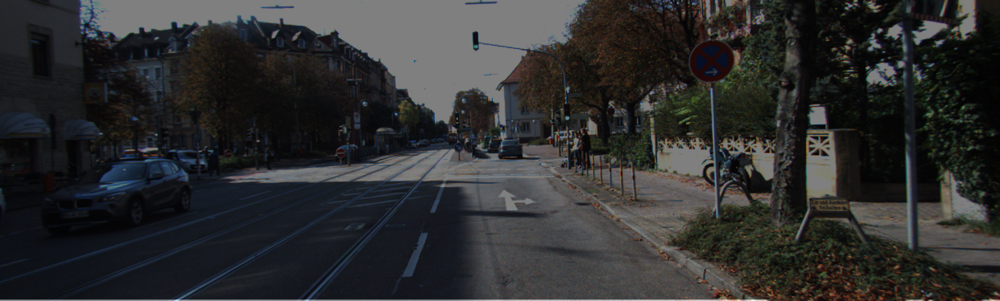

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_2_2, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_2_2, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.012879


0.012878906863515

##### 3) Nadam(5e-4)

In [ ]:
unet_pp_2_3 = build_model((224, 224, 3), 64, 3)
unet_pp_2_3.compile(optimizer = tf.keras.optimizers.Nadam(5e-4), loss="binary_crossentropy")

In [ ]:
unet_pp_2_3.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=100
                )

unet_pp_2_3.save(model_path + '/unet_pp_2_3.h5')

Epoch 1/100
11/11 [==============================] - 23s 1s/step - loss: 0.9888 - val_loss: 0.6922
Epoch 2/100
11/11 [==============================] - 10s 917ms/step - loss: 0.7391 - val_loss: 0.6890
Epoch 3/100
11/11 [==============================] - 10s 919ms/step - loss: 0.7033 - val_loss: 0.6867
Epoch 4/100
11/11 [==============================] - 10s 918ms/step - loss: 0.6863 - val_loss: 0.6853
Epoch 5/100
11/11 [==============================] - 10s 917ms/step - loss: 0.6840 - val_loss: 0.6829
Epoch 6/100
11/11 [==============================] - 10s 919ms/step - loss: 0.6795 - val_loss: 0.6811
Epoch 7/100
11/11 [==============================] - 10s 917ms/step - loss: 0.6810 - val_loss: 0.6786
Epoch 8/100
11/11 [==============================] - 10s 917ms/step - loss: 0.6770 - val_loss: 0.6786
Epoch 9/100
11/11 [==============================] - 10s 917ms/step - loss: 0.6736 - val_loss: 0.6759
Epoch 10/100
11/11 [==============================] - 10s 916ms/step - loss: 0.6704 -

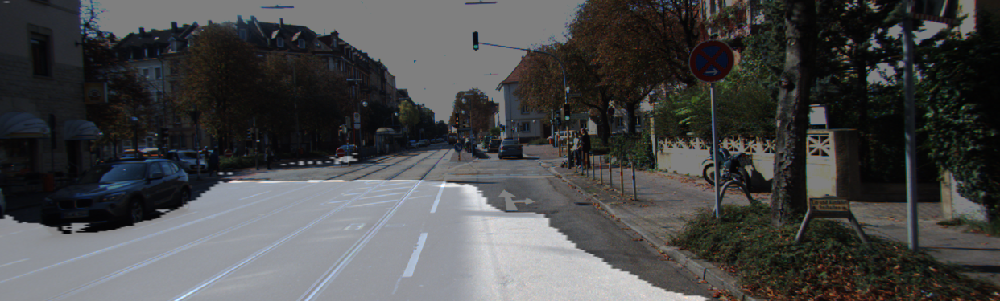

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_2_3, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_2_3, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.778011


0.778011368060422

##### 4) Nadam(1e-4)

In [ ]:
unet_pp_2_4 = build_model((224, 224, 3), 64, 3)
unet_pp_2_4.compile(optimizer = tf.keras.optimizers.Nadam(1e-4), loss="binary_crossentropy")

In [ ]:
unet_pp_2_4.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=100
                )

unet_pp_2_4.save(model_path + '/unet_pp_2_4.h5')

Epoch 1/100
11/11 [==============================] - 23s 1s/step - loss: 0.5148 - val_loss: 0.6880
Epoch 2/100
11/11 [==============================] - 10s 934ms/step - loss: 0.3001 - val_loss: 0.6811
Epoch 3/100
11/11 [==============================] - 10s 920ms/step - loss: 0.2589 - val_loss: 0.6670
Epoch 4/100
11/11 [==============================] - 10s 920ms/step - loss: 0.2468 - val_loss: 0.6719
Epoch 5/100
11/11 [==============================] - 10s 940ms/step - loss: 0.2417 - val_loss: 0.6683
Epoch 6/100
11/11 [==============================] - 10s 927ms/step - loss: 0.2384 - val_loss: 0.6855
Epoch 7/100
11/11 [==============================] - 10s 925ms/step - loss: 0.2374 - val_loss: 0.6766
Epoch 8/100
11/11 [==============================] - 10s 931ms/step - loss: 0.2312 - val_loss: 0.6130
Epoch 9/100
11/11 [==============================] - 10s 919ms/step - loss: 0.2264 - val_loss: 0.6356
Epoch 10/100
11/11 [==============================] - 10s 917ms/step - loss: 0.2211 -

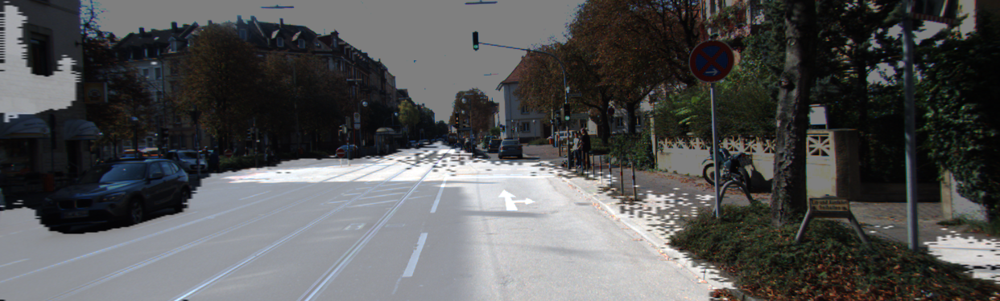

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_2_4, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_2_4, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.840880


0.8408798646362098

##### 5) Nadam(5e-5)

In [ ]:
unet_pp_2_5 = build_model((224, 224, 3), 64, 3)
unet_pp_2_5.compile(optimizer = tf.keras.optimizers.Nadam(5e-5), loss="binary_crossentropy")

In [ ]:
unet_pp_2_5.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=100
                )

unet_pp_2_5.save(model_path + '/unet_pp_2_5.h5')

Epoch 1/100
11/11 [==============================] - 44s 2s/step - loss: 0.9651 - val_loss: 0.6981
Epoch 2/100
11/11 [==============================] - 9s 854ms/step - loss: 0.8438 - val_loss: 0.7003
Epoch 3/100
11/11 [==============================] - 9s 848ms/step - loss: 0.7837 - val_loss: 0.7019
Epoch 4/100
11/11 [==============================] - 9s 848ms/step - loss: 0.7595 - val_loss: 0.7038
Epoch 5/100
11/11 [==============================] - 9s 861ms/step - loss: 0.7507 - val_loss: 0.7034
Epoch 6/100
11/11 [==============================] - 10s 875ms/step - loss: 0.7354 - val_loss: 0.7038
Epoch 7/100
11/11 [==============================] - 9s 856ms/step - loss: 0.7230 - val_loss: 0.7047
Epoch 8/100
11/11 [==============================] - 10s 869ms/step - loss: 0.7151 - val_loss: 0.7046
Epoch 9/100
11/11 [==============================] - 9s 857ms/step - loss: 0.7088 - val_loss: 0.6999
Epoch 10/100
11/11 [==============================] - 9s 862ms/step - loss: 0.7075 - val_lo

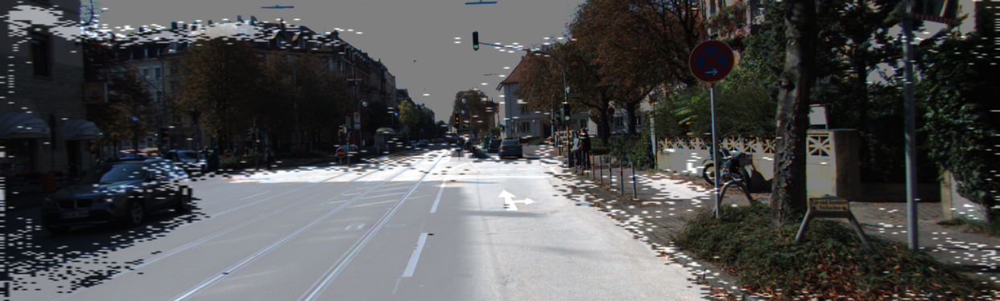

In [ ]:
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_2_5, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_2_5, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.793771


0.7937710437710438

### 2.2 Epoch

#### 2.2.1 Epoch 1000

In [ ]:
unet_pp_3_1 = build_model((224, 224, 3), 64, 3)
unet_pp_3_1.compile(optimizer = tf.keras.optimizers.Adam(1e-4), loss="binary_crossentropy")

In [ ]:
unet_pp_3_1.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=1000
                )

unet_pp_3_1.save(model_path + '/unet_pp_3_1.h5')

Epoch 1/1000
11/11 [==============================] - 14s 964ms/step - loss: 0.7126 - val_loss: 0.6934
Epoch 2/1000
11/11 [==============================] - 10s 899ms/step - loss: 0.6964 - val_loss: 0.6944
Epoch 3/1000
11/11 [==============================] - 10s 899ms/step - loss: 0.6922 - val_loss: 0.6951
Epoch 4/1000
11/11 [==============================] - 10s 899ms/step - loss: 0.6884 - val_loss: 0.6955
Epoch 5/1000
11/11 [==============================] - 10s 899ms/step - loss: 0.6820 - val_loss: 0.6944
Epoch 6/1000
11/11 [==============================] - 10s 899ms/step - loss: 0.6828 - val_loss: 0.6906
Epoch 7/1000
11/11 [==============================] - 10s 900ms/step - loss: 0.6764 - val_loss: 0.6893
Epoch 8/1000
11/11 [==============================] - 10s 899ms/step - loss: 0.6720 - val_loss: 0.6915
Epoch 9/1000
11/11 [==============================] - 10s 899ms/step - loss: 0.6768 - val_loss: 0.6895
Epoch 10/1000
11/11 [==============================] - 10s 899ms/step - l

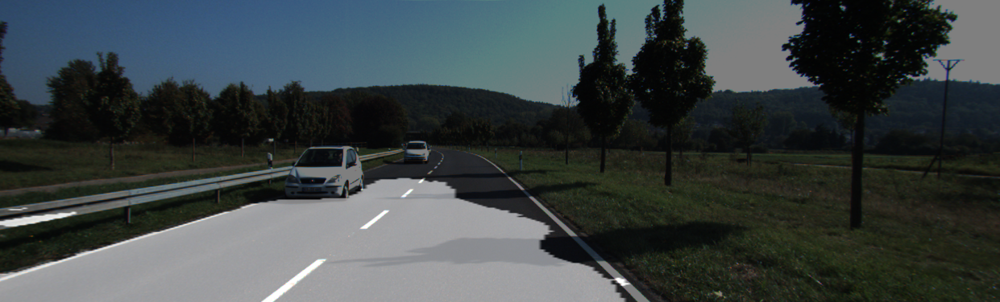

In [ ]:
i = 180   # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_3_1, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_3_1, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.822160


0.822160436618268

#### 2.2.2 Epoch 1500

In [ ]:
# model load
unet_pp_3_2 = tf.keras.models.load_model(model_path + '/unet_pp_3_1.h5')

In [ ]:
unet_pp_3_2.fit(train_generator,
                validation_data=test_generator,
                steps_per_epoch=len(train_generator),
                epochs=500
                )

unet_pp_3_2.save(model_path + '/unet_pp_3_2.h5')

Epoch 1/500
11/11 [==============================] - 13s 980ms/step - loss: 0.0023 - val_loss: 0.0151
Epoch 2/500
11/11 [==============================] - 10s 902ms/step - loss: 0.0019 - val_loss: 0.0152
Epoch 3/500
11/11 [==============================] - 10s 899ms/step - loss: 0.0016 - val_loss: 0.0130
Epoch 4/500
11/11 [==============================] - 10s 900ms/step - loss: 0.0017 - val_loss: 0.0117
Epoch 5/500
11/11 [==============================] - 10s 900ms/step - loss: 0.0028 - val_loss: 0.0114
Epoch 6/500
11/11 [==============================] - 10s 898ms/step - loss: 0.0021 - val_loss: 0.0124
Epoch 7/500
11/11 [==============================] - 10s 901ms/step - loss: 0.0026 - val_loss: 0.0147
Epoch 8/500
11/11 [==============================] - 10s 899ms/step - loss: 0.0021 - val_loss: 0.0128
Epoch 9/500
11/11 [==============================] - 10s 899ms/step - loss: 0.0018 - val_loss: 0.0741
Epoch 10/500
11/11 [==============================] - 10s 899ms/step - loss: 0.004

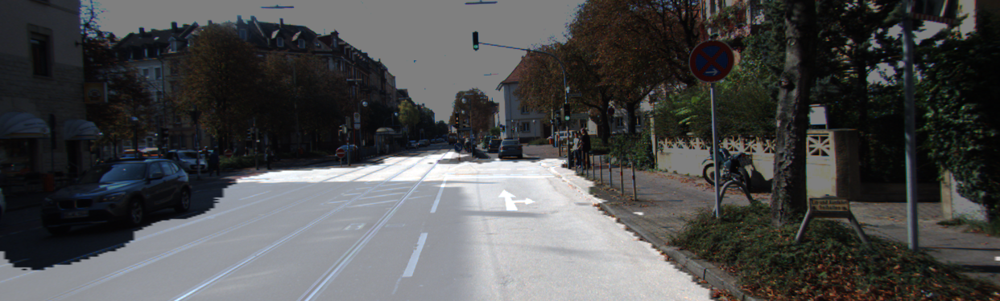

In [ ]:
i = 1  # i값을 바꾸면 테스트용 파일이 달라집니다. 

get_output(unet_pp_3_2, 
           test_preproc, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
output, prediction, target = get_output_2(unet_pp_3_2, 
                                          test_preproc, 0.5, 
                                          image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
                                          output_path=dir_path + f'./result_{str(i).zfill(3)}.png', 
                                          label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                          )

calculate_iou_score(target, prediction)

IoU : 0.879904


0.8799038610637309

## 3. Compare

In [ ]:
# model load
# unet_0 = tf.keras.models.load_model(model_path + '/unet_0.h5')
# unet_pp_00 = tf.keras.models.load_model(model_path + '/unet_pp_0.h5')
unet_pp_01 = tf.keras.models.load_model(model_path + '/unet_pp_3_1.h5')
unet_pp_02 = tf.keras.models.load_model(model_path + '/unet_pp_3_2.h5')

In [ ]:
i = 1  # i값을 바꾸면 테스트용 파일이 달라집니다. 

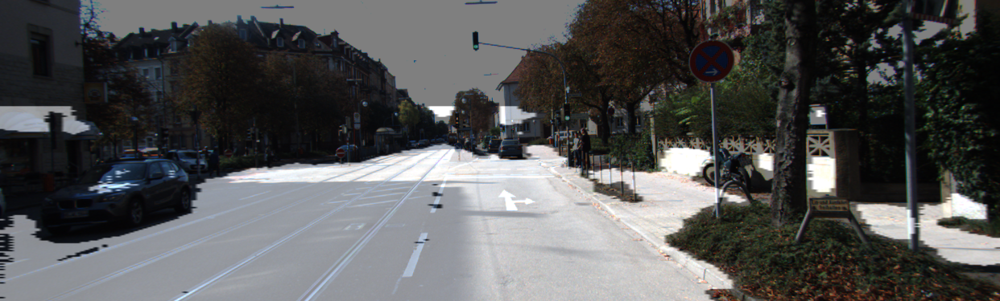

In [ ]:
get_output(unet_0, 
           test_preproc,
           0.5, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

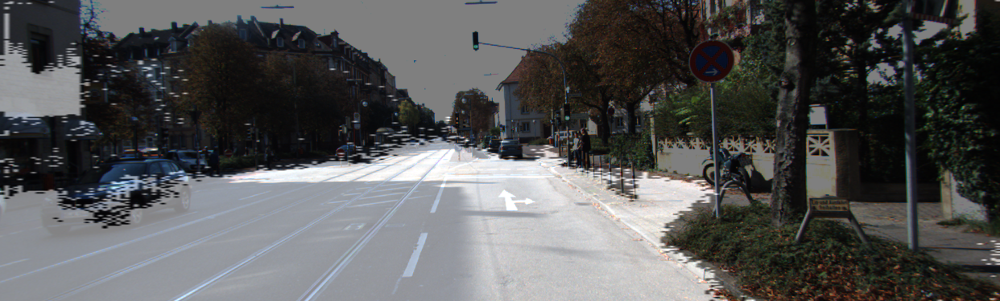

In [ ]:
get_output(unet_pp_0, 
           test_preproc, 
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

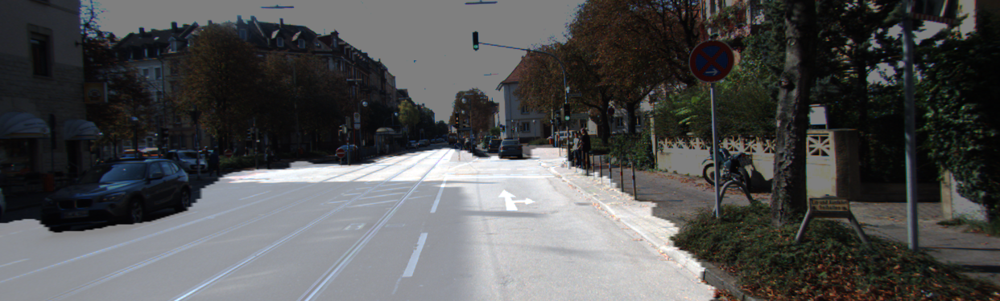

In [ ]:
get_output(unet_pp_01, 
           test_preproc, 
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

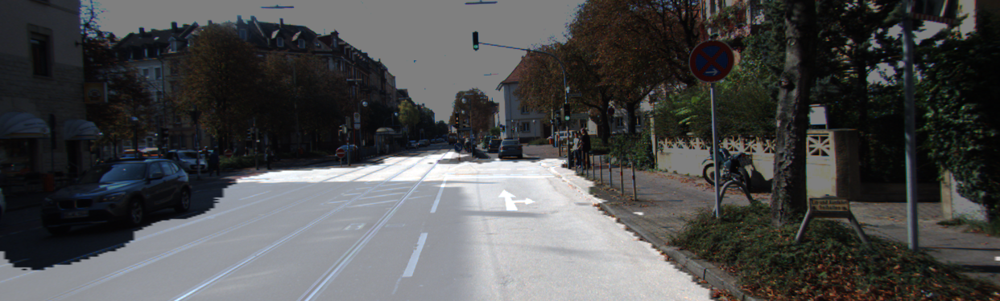

In [ ]:
get_output(unet_pp_02, 
           test_preproc, 
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
i = 50  # i값을 바꾸면 테스트용 파일이 달라집니다. 

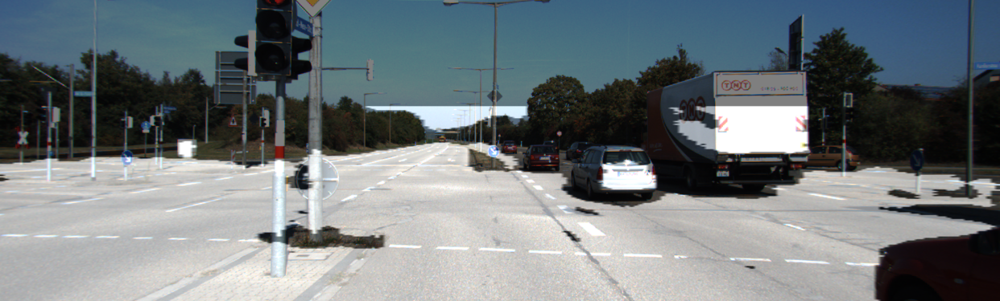

In [ ]:
get_output(unet_0, 
           test_preproc, 
           0.5, 
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

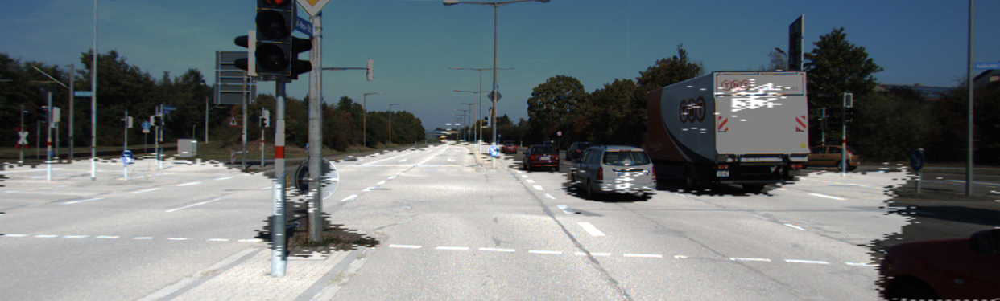

In [ ]:
get_output(unet_pp_0, 
           test_preproc,  
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

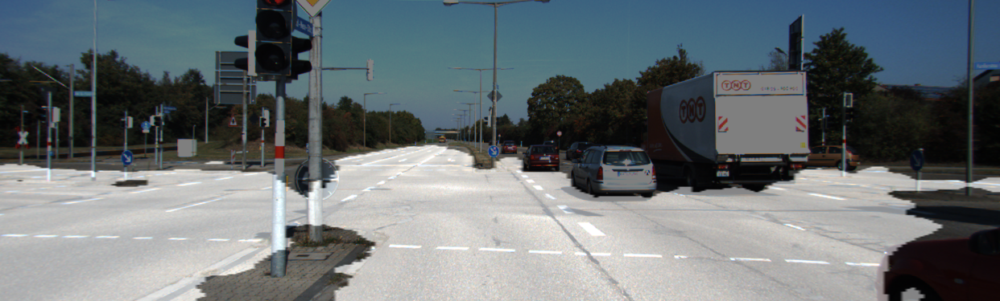

In [ ]:
get_output(unet_pp_01, 
           test_preproc,  
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

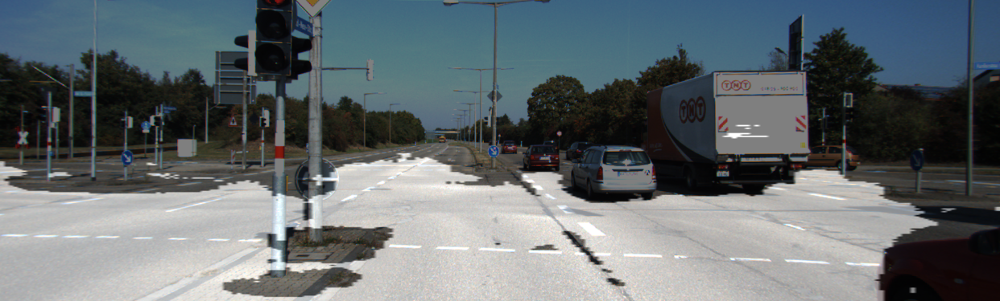

In [ ]:
get_output(unet_pp_02, 
           test_preproc,  
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
i = 100  # i값을 바꾸면 테스트용 파일이 달라집니다. 

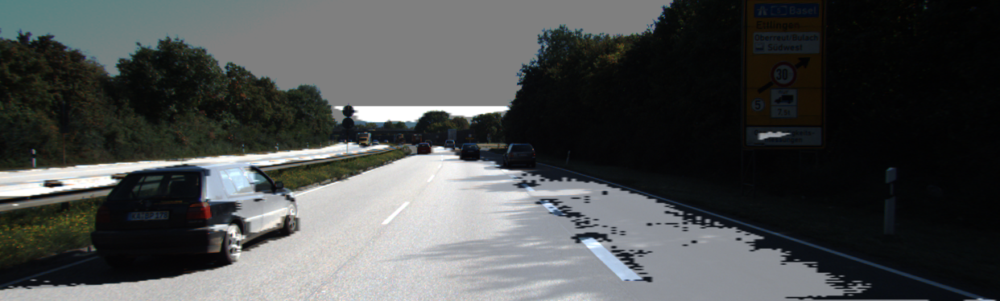

In [ ]:
get_output(unet_0, 
           test_preproc,  
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

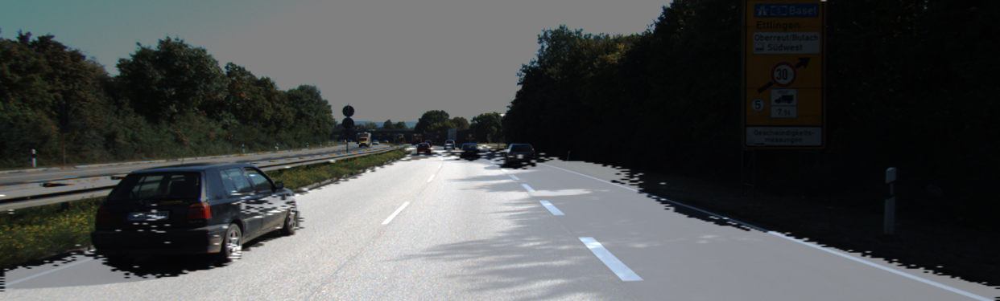

In [ ]:
get_output(unet_pp_0, 
           test_preproc,  
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

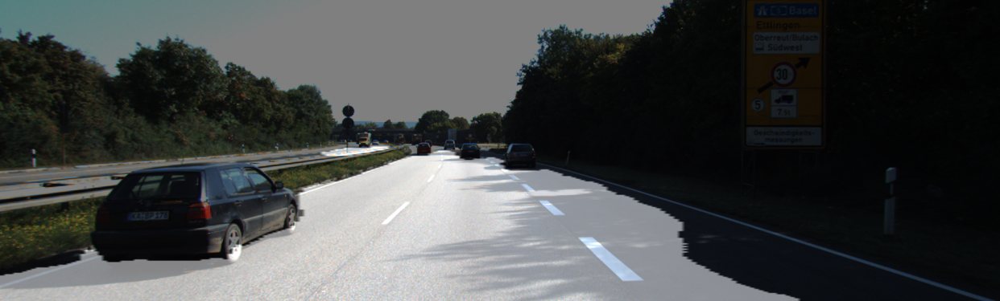

In [ ]:
get_output(unet_pp_01, 
           test_preproc,  
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

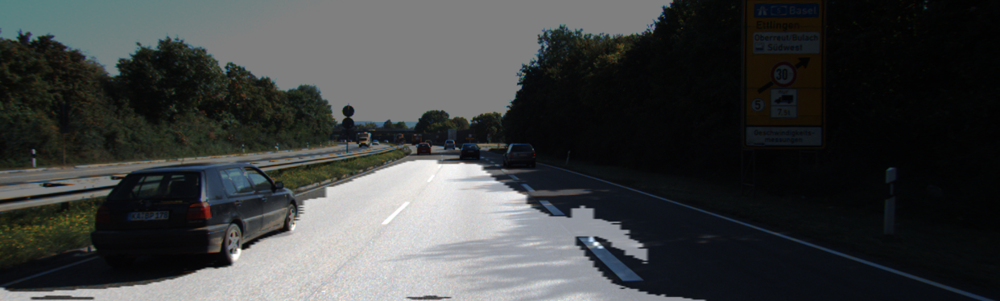

In [ ]:
get_output(unet_pp_02, 
           test_preproc,  
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

In [ ]:
i = 150  # i값을 바꾸면 테스트용 파일이 달라집니다. 

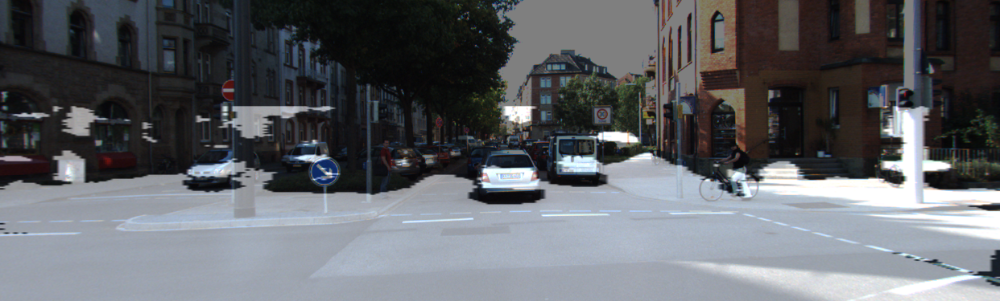

In [ ]:
get_output(unet_0, 
           test_preproc,  
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

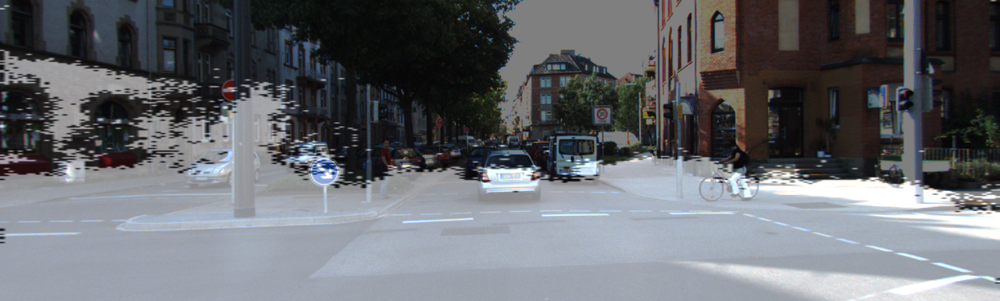

In [ ]:
get_output(unet_pp_0, 
           test_preproc,  
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

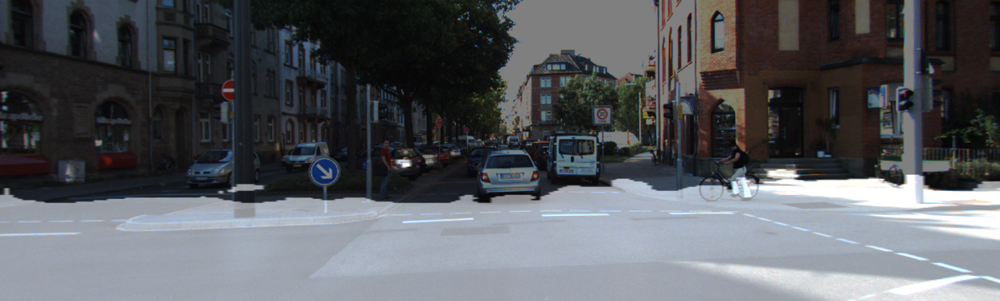

In [ ]:
get_output(unet_pp_01, 
           test_preproc,  
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

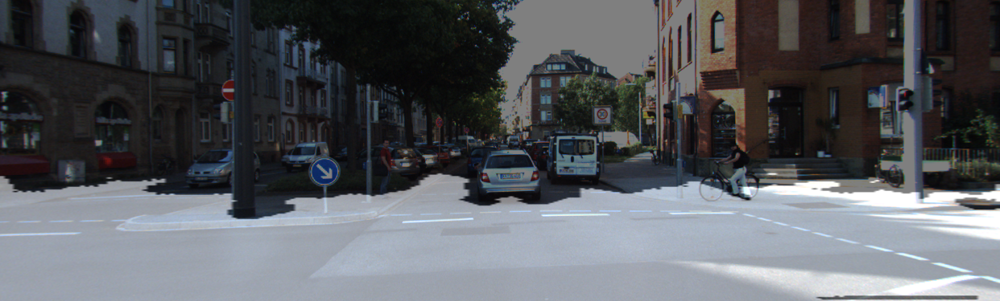

In [ ]:
get_output(unet_pp_02, 
           test_preproc,  
           0.5,
           image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png', 
           output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
           )

### 3.1 picture_1

#### 3.1.1 Unet (default)

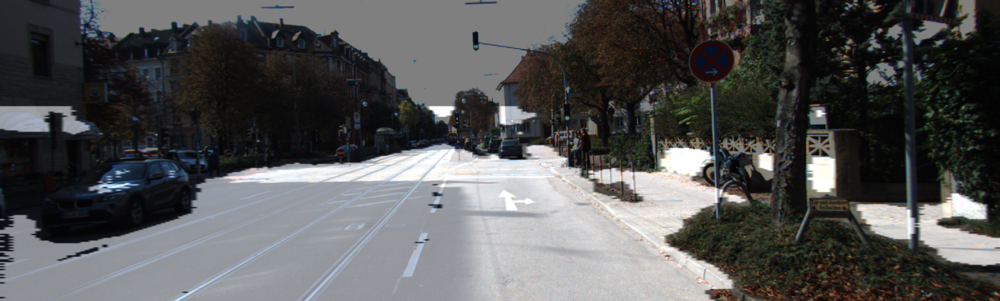

In [ ]:
insert_img_01 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/0_0.png')
cv2_imshow(insert_img_01)

#### 3.1.2 Unet++ (default)

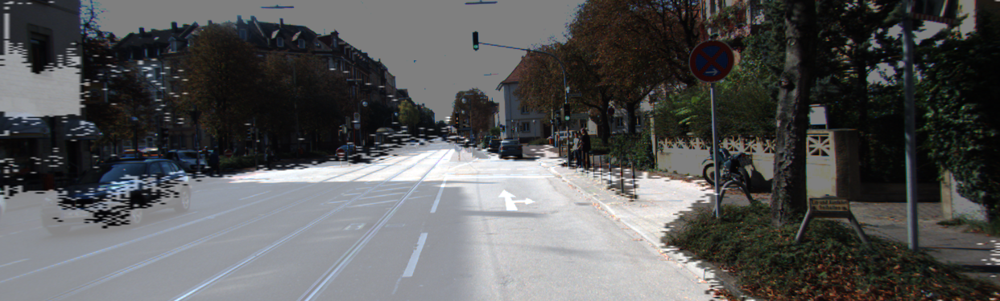

In [ ]:
insert_img_02 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/0_1.png')
cv2_imshow(insert_img_02)

#### 3.1.3 Unet++ (epoch 1000)

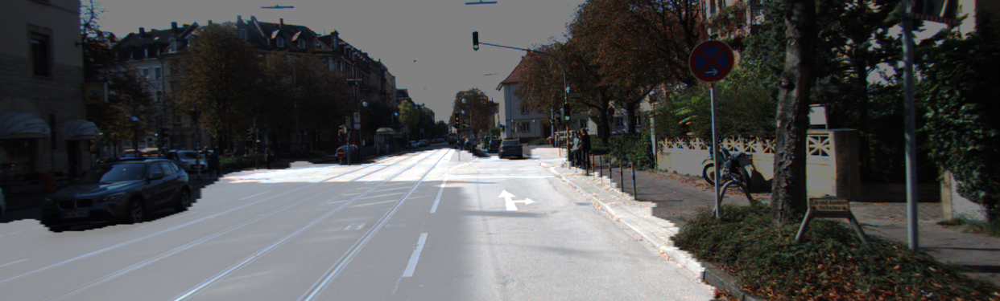

In [ ]:
insert_img_03 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/0_2.png')
cv2_imshow(insert_img_03)

#### 3.1.4 Unet++ (epoch 1500)

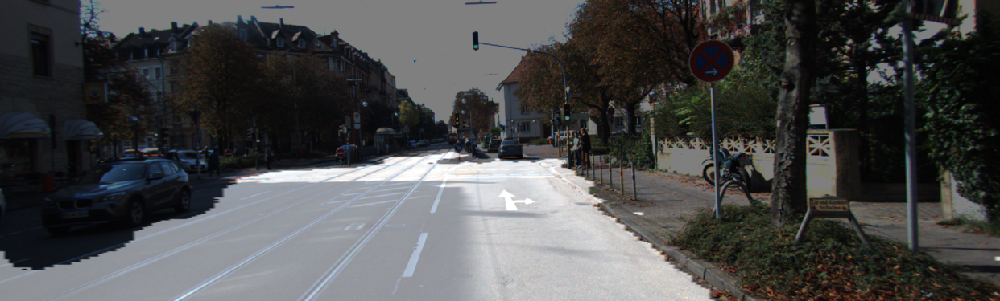

In [ ]:
insert_img_04 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/0_3.png')
cv2_imshow(insert_img_04)

### 3.2 picture_2

#### 3.2.1 Unet (default)

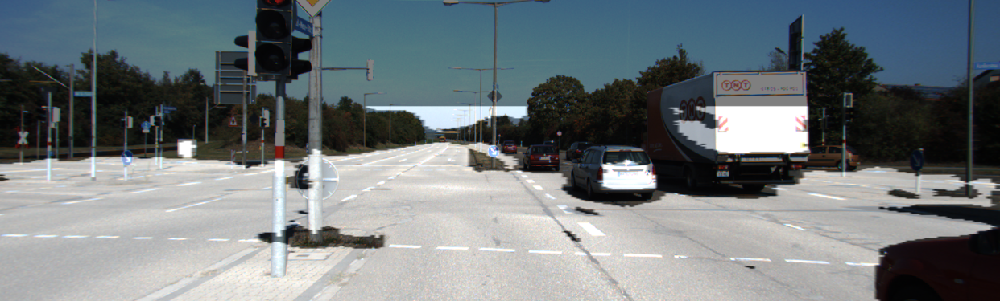

In [ ]:
insert_img_05 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/1_0.png')
cv2_imshow(insert_img_05)

#### 3.2.2 Unet++ (default)

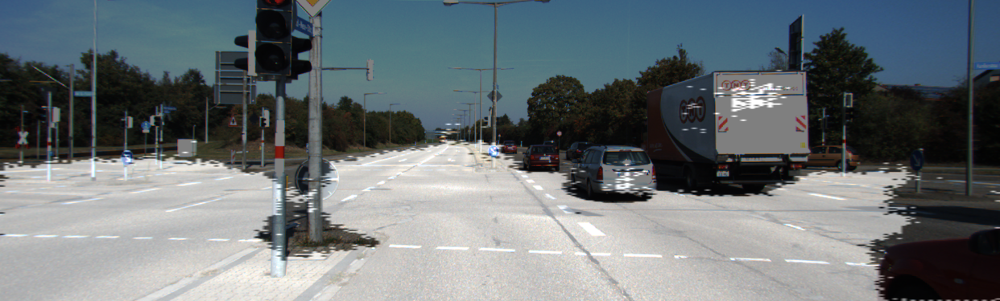

In [ ]:
insert_img_06 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/1_1.png')
cv2_imshow(insert_img_06)

#### 3.2.3 Unet++ (epoch 1000)

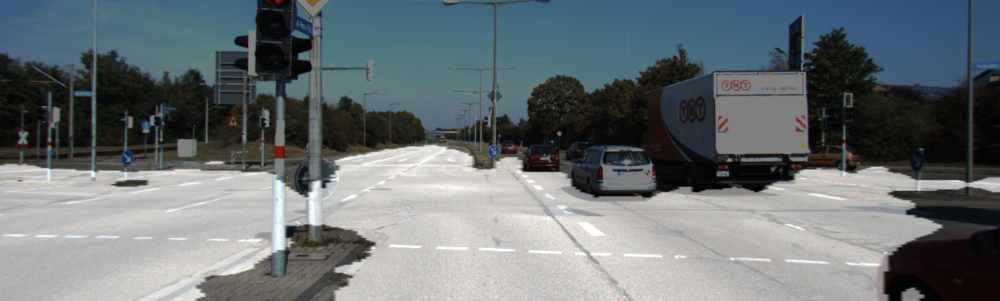

In [ ]:
insert_img_07 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/1_2.png')
cv2_imshow(insert_img_07)

#### 3.2.4 Unet++ (epoch 1500)

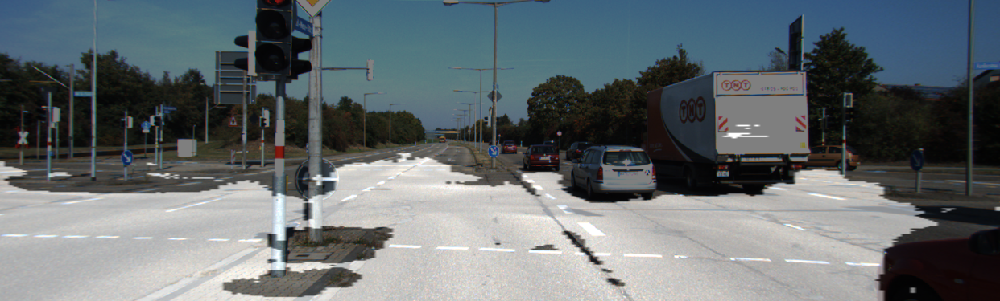

In [ ]:
insert_img_08 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/1_3.png')
cv2_imshow(insert_img_08)

### 3.3 picture_3

#### 3.3.1 Unet (default)

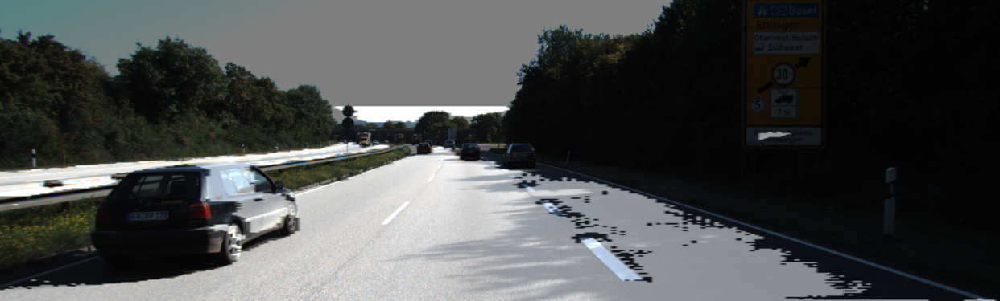

In [ ]:
insert_img_09 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/2_0.png')
cv2_imshow(insert_img_09)

#### 3.3.2 Unet++ (default)

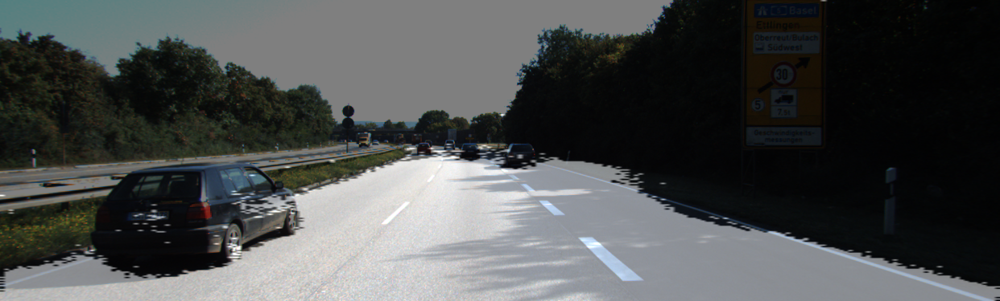

In [ ]:
insert_img_10 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/2_1.png')
cv2_imshow(insert_img_10)

#### 3.3.3 Unet++ (epoch 1000)

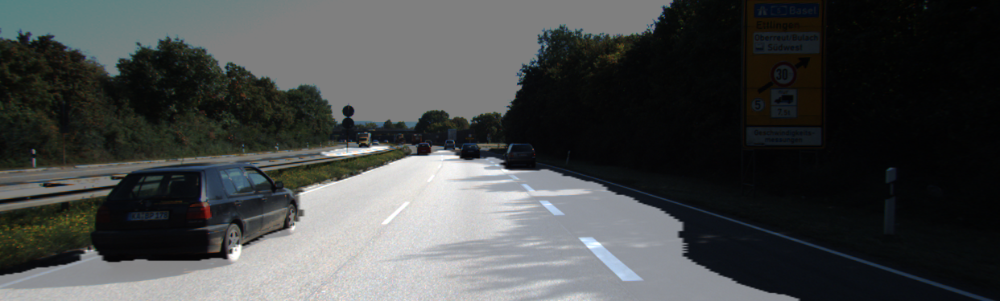

In [ ]:
insert_img_11 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/2_2.png')
cv2_imshow(insert_img_11)

#### 3.3.4 Unet++ (epoch 1500)

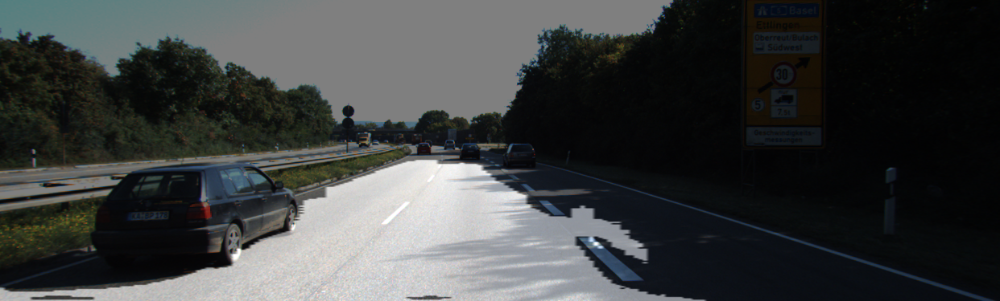

In [ ]:
insert_img_12 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/2_3.png')
cv2_imshow(insert_img_12)

### 3.4 picture_4

#### 3.4.1 Unet (default)

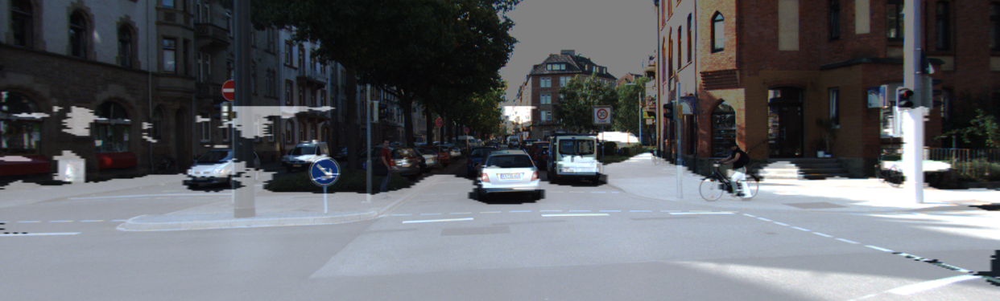

In [ ]:
insert_img_13 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/3_0.png')
cv2_imshow(insert_img_13)

#### 3.4.2 Unet++ (default)

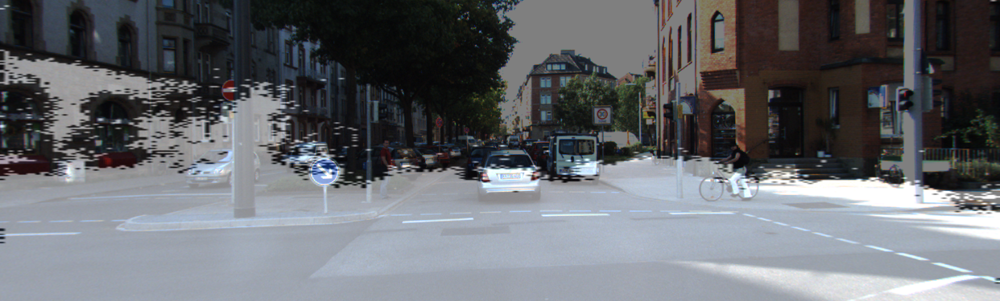

In [ ]:
insert_img_14 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/3_1.png')
cv2_imshow(insert_img_14)

#### 3.4.3 Unet++ (epoch 1000)

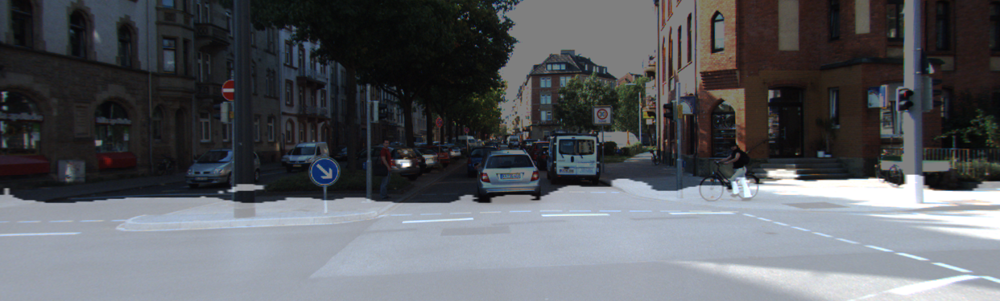

In [ ]:
insert_img_15 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/3_2.png')
cv2_imshow(insert_img_15)

#### 3.4.4 Unet++ (epoch 1500)

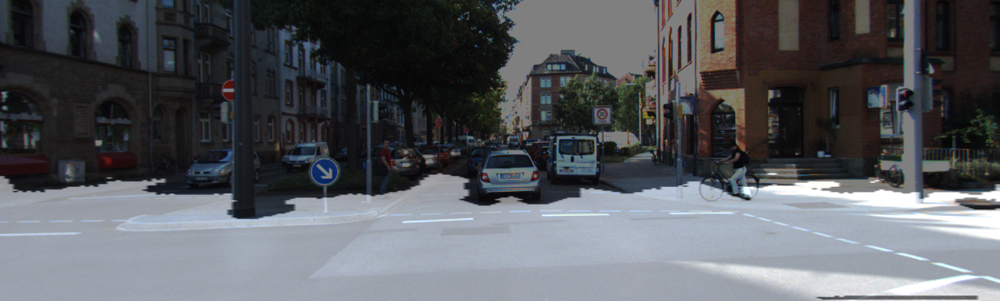

In [ ]:
insert_img_16 = cv2.imread('/gdrive/MyDrive/Colab Notebooks/semantic_segmentation/data/train/prediction/3_3.png')
cv2_imshow(insert_img_16)

## 4. Retrospect

##### 1) IoU
- 사실 model의 문제인지 task의 문제인지 잘 모르겠습니다.  
Optimizer도 바꾸고 learning rate도 바꾸면서 확인해봤으나 이유를 못 찾겠습니다.  
같은 조건의 모델을 수행할 때도 IoU 값이 0.7 이상 차이 나는 경우도 확인했습니다.   
편차가 너무 크다 보니 랜덤한 값을 output으로 뽑아낸다고 느낄 정도입니다.  
모델 자체가 이런 task에 적합하지 않다고 생각합니다.

##### 2) Epoch
- 위 문제에 대해 고민 해봤습니다.  
모델을 학습하기에 epoch이 너무 적은 것은 아닐까 하여 epoch 1000을 추가 수행했습니다.  
epoch 1000도 만족스럽지는 않지만 100번 돌린 것에 비해 개선된 것으로 판단됩니다.  
더 이상의 학습은 의미가 없어 보입니다.

## 5. References

##### 1) KITTI
- http://www.cvlibs.net/datasets/kitti/
- http://www.cvlibs.net/datasets/kitti/eval_semantics.php

##### 2) Unet++
- https://arxiv.org/abs/1807.10165
- https://arxiv.org/abs/1912.05074
- https://arxiv.org/abs/2205.11759

##### 3) Unet
- https://arxiv.org/abs/2203.08194
- https://github.com/milesial/Pytorch-UNet